
# CycleGAN Experiment 4: U-Net Generator (No Augmentations)

This notebook replicates Experiment 3 (U-Net) but **removes all data augmentations** (RandomCrop, RandomFlip).
It also enhances logging to show the source image alongside the generated one.


In [1]:
# Mount Google Drive
try:
    from google.colab import drive
    drive.mount('/content/drive')
except ImportError:
    print("Not running in Google Colab. Skipping Drive mount.")

Mounted at /content/drive


In [3]:
import os
import shutil

# --- CONFIGURATION ---
REPO_PATH = '/content/drive/MyDrive/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition'
# Use your actual token here if the repo is private, or just the https link if public
# Since I don't have your token, I'll assume you want to clone via HTTPS or SSH
# REPLACE THIS URL with your actual repo URL
REPO_URL = "https://github.com/konstantine25b/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition.git"

# 1. Remove existing repository if it exists
if os.path.exists(REPO_PATH):
    print(f"Removing existing repository at {REPO_PATH}...")
    try:
        shutil.rmtree(REPO_PATH)
        print("✅ Removed old repository.")
    except Exception as e:
        print(f"❌ Error removing repository: {e}")

# 2. Clone fresh copy
print(f"Cloning fresh repository from {REPO_URL}...")
# We cd to the parent directory first
os.chdir('/content/drive/MyDrive')
!git clone {REPO_URL}

# 3. Enter the repository
if os.path.exists(REPO_PATH):
    os.chdir(REPO_PATH)
    print(f"✅ Successfully cloned and entered: {os.getcwd()}")
    !ls
else:
    print("❌ Clone failed. Please check your URL or permissions.")

Removing existing repository at /content/drive/MyDrive/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition...
✅ Removed old repository.
Cloning fresh repository from https://github.com/konstantine25b/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition.git...
Cloning into 'Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition'...
remote: Enumerating objects: 7474, done.
remote: Counting objects: 100% (21/21), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 7474 (delta 8), reused 16 (delta 3), pack-reused 7453 (from 3)
Receiving objects: 100% (7474/7474), 525.53 MiB | 20.17 MiB/s, done.
Resolving deltas: 100% (41/41), done.
Updating files: 100% (7386/7386), done.
✅ Successfully cloned and entered: /content/drive/MyDrive/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition
data  notebooks  README.md  requirements.txt  src


In [2]:
import os
import shutil

# --- CONFIGURATION ---
try:
    import google.colab
    IN_COLAB = True
except:
    IN_COLAB = False

if IN_COLAB:
    REPO_PATH = '/content/drive/MyDrive/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition'
    CHECKPOINT_DIR = '/content/drive/MyDrive/MonetGAN_Checkpoints_Exp1'

    # Clone if not exists
    if not os.path.exists(REPO_PATH):
        print("Repository not found in Drive. Please clone it first (see experiment2.ipynb).")
    else:
        os.chdir(REPO_PATH)
        print(f"Changed directory to {REPO_PATH}")
else:
    # Local fallback
    REPO_PATH = os.path.abspath(os.path.join(os.getcwd(), '..'))
    CHECKPOINT_DIR = os.path.join(REPO_PATH, 'checkpoints')
    if os.path.exists(REPO_PATH):
        os.chdir(REPO_PATH)
        print(f"Changed directory to {REPO_PATH}")

os.makedirs(CHECKPOINT_DIR, exist_ok=True)
print(f"Checkpoints will be saved to: {CHECKPOINT_DIR}")

Changed directory to /content/drive/MyDrive/Kaggle_GANS_I-m-Something-of-a-Painter-Myself_Competition
Checkpoints will be saved to: /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


In [3]:
!pip install wandb -q

In [3]:
import wandb
import sys
import os
import glob
import re
import random
import time
import itertools
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm.notebook import tqdm

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import torchvision.utils as vutils
import torchvision.transforms as transforms

# Add src to path so we can import modules
sys.path.append('src')

# Import U-Net Generator instead of ResNet
from models.generator.unet_gan import UNetGenerator
from models.discriminator.patch_gan import PatchDiscriminator
from utils.dataset import ImageDataset, get_transforms
from utils.helpers import ReplayBuffer, weights_init_normal

In [6]:
!wandb login

wandb: Logging into https://api.wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: Find your API key here: https://wandb.ai/authorize?ref=models
wandb: Paste an API key from your profile and hit enter: 
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: konstantine25b (konstantine25b-free-university-of-tbilisi-) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


In [18]:
# --- CONFIGURATION ---
MONET_PATH = 'data/monet_jpg'
PHOTO_PATH = 'data/photo_jpg'

BATCH_SIZE = 4
N_EPOCHS = 30
LR = 0.0002
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {DEVICE}")


Using device: cuda


In [8]:

# Initialize WandB
wandb.init(
    project="Monet_GAN_Experiment4_UNet_NoAug",
    entity="konstantine25b-free-university-of-tbilisi-",
    config={
        "epochs": N_EPOCHS,
        "batch_size": BATCH_SIZE,
        "learning_rate": LR,
        "architecture": "CycleGAN-UNet", # Changed to U-Net
        "dataset": "Monet2Photo",
        "experiment": "Experiment 4 (U-Net, No Aug)"
    }
)

/usr/local/lib/python3.12/dist-packages/notebook/notebookapp.py:191: SyntaxWarning: invalid escape sequence '\/'
  | |_| | '_ \/ _` / _` |  _/ -_)
wandb: Currently logged in as: konstantine25b (konstantine25b-free-university-of-tbilisi-) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


In [26]:
# Data Loading
monet_files = sorted(glob.glob(os.path.join(MONET_PATH, "*.*")))
photo_files = sorted(glob.glob(os.path.join(PHOTO_PATH, "*.*")))

print(f"Total Monet images: {len(monet_files)}")
print(f"Total Photo images: {len(photo_files)}")

random.seed(42)
random.shuffle(monet_files)
random.shuffle(photo_files)

def split_data(files, is_monet=False):
    n_val = 1 if is_monet else 50
    if is_monet:
        val = files[:n_val]
        train = files[n_val:]
        test = []
    else:
        n_test = 30
        val = files[:n_val]
        test = files[n_val:n_val+n_test]
        train = files[n_val+n_test:]
    return train, val, test

monet_train, monet_val, monet_test = split_data(monet_files, is_monet=True)
photo_train, photo_val, photo_test = split_data(photo_files, is_monet=False)


# transforms_ = get_transforms() # Original with augmentation

# Experiment 4: No Augmentations (Resize Only)
transforms_ = transforms.Compose([
    transforms.Resize((256, 256), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

train_dataset = ImageDataset(monet_train, photo_train, transform=transforms_)
val_dataset = ImageDataset(monet_val, photo_val, transform=transforms_)
test_dataset = ImageDataset(monet_val, photo_test, transform=transforms_)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

Total Monet images: 300
Total Photo images: 7038


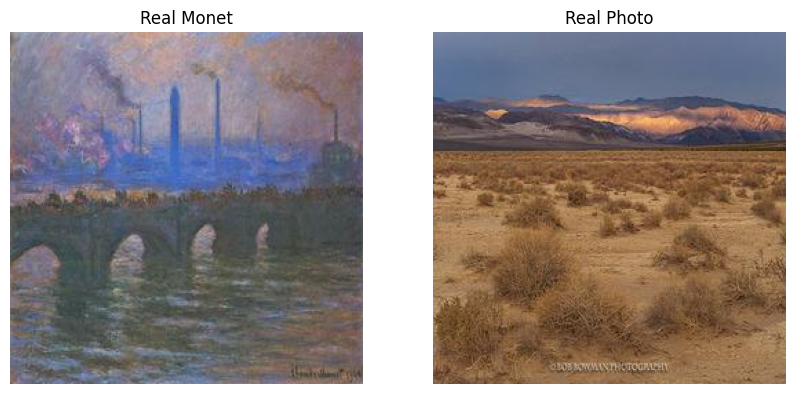

In [27]:
def denormalize(tensor):
    return tensor * 0.5 + 0.5

# Visualize Data
batch = next(iter(train_loader))
real_monet = batch['monet']
real_photo = batch['photo']

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(denormalize(real_monet[0]).permute(1, 2, 0).cpu().numpy())
plt.title("Real Monet")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(denormalize(real_photo[0]).permute(1, 2, 0).cpu().numpy())
plt.title("Real Photo")
plt.axis('off')
plt.show()

In [28]:
# Model Initialization (U-Net)
G_Monet = UNetGenerator(ngf=16).to(DEVICE) # Using U-Net
G_Photo = UNetGenerator(ngf=16).to(DEVICE)
D_Monet = PatchDiscriminator().to(DEVICE)
D_Photo = PatchDiscriminator().to(DEVICE)

G_Monet.apply(weights_init_normal)
G_Photo.apply(weights_init_normal)
D_Monet.apply(weights_init_normal)
D_Photo.apply(weights_init_normal)

criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_Monet.parameters(), G_Photo.parameters()),
    lr=LR, betas=(0.5, 0.999)
)
optimizer_D_Monet = torch.optim.Adam(D_Monet.parameters(), lr=LR, betas=(0.5, 0.999))
optimizer_D_Photo = torch.optim.Adam(D_Photo.parameters(), lr=LR, betas=(0.5, 0.999))

lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(
    optimizer_G, lr_lambda=lambda epoch: 1.0 - max(0, epoch - 25) / float(50 - 25 + 1)
)
lr_scheduler_D_Monet = torch.optim.lr_scheduler.LambdaLR(
    optimizer_D_Monet, lr_lambda=lambda epoch: 1.0 - max(0, epoch - 25) / float(50 - 25 + 1)
)
lr_scheduler_D_Photo = torch.optim.lr_scheduler.LambdaLR(
    optimizer_D_Photo, lr_lambda=lambda epoch: 1.0 - max(0, epoch - 25) / float(50 - 25 + 1)
)

In [29]:
# Resume Logic (checking for _3 suffix for experiment 3 if any, or starting fresh)
def find_latest_checkpoint(checkpoint_dir):
    files = glob.glob(os.path.join(checkpoint_dir, "G_Monet_epoch_*_4.pth"))
    if not files:
        return 0
    epochs = [int(re.search(r'epoch_(\d+)_4.pth', f).group(1)) for f in files]
    return max(epochs)

start_epoch = find_latest_checkpoint(CHECKPOINT_DIR)

if start_epoch > 0:
    print(f"Found checkpoint! Resuming from epoch {start_epoch}...")
    G_Monet.load_state_dict(torch.load(os.path.join(CHECKPOINT_DIR, f'G_Monet_epoch_{start_epoch}_4.pth'), map_location=DEVICE))
    G_Photo.load_state_dict(torch.load(os.path.join(CHECKPOINT_DIR, f'G_Photo_epoch_{start_epoch}_4.pth'), map_location=DEVICE))
    D_Monet.load_state_dict(torch.load(os.path.join(CHECKPOINT_DIR, f'D_Monet_epoch_{start_epoch}_4.pth'), map_location=DEVICE))
    D_Photo.load_state_dict(torch.load(os.path.join(CHECKPOINT_DIR, f'D_Photo_epoch_{start_epoch}_4.pth'), map_location=DEVICE))

    for _ in range(start_epoch):
        lr_scheduler_G.step()
        lr_scheduler_D_Monet.step()
        lr_scheduler_D_Photo.step()
else:
    print("No checkpoint found. Starting from scratch.")

No checkpoint found. Starting from scratch.


Starting training from epoch 0 to 30...


Epoch 1/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 1 finished. Avg Generator Loss: 2.4393
  > D_Monet Loss: 0.3311 | D_Photo Loss: 0.1869
  > Cycle Loss: 0.0882 | Identity Loss: 0.0802 | GAN Loss: 0.2943
--- Visualizing Epoch 1 Results ---


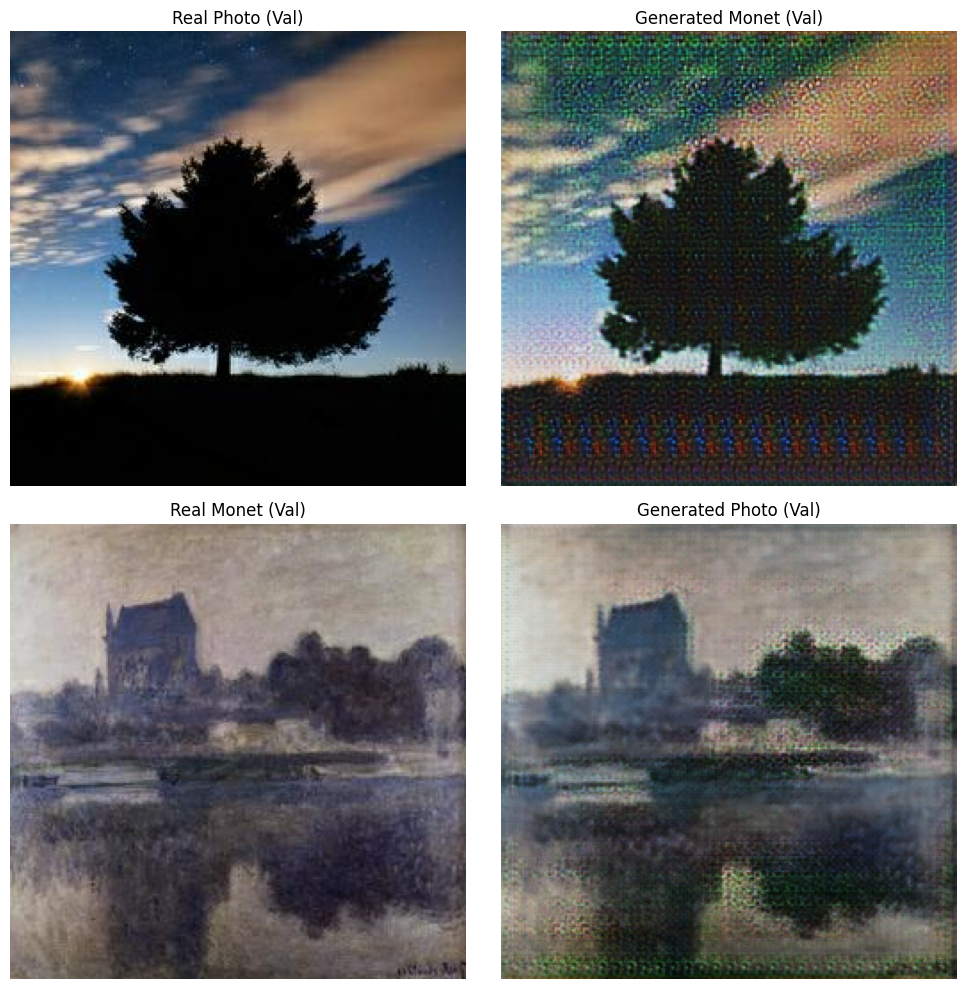

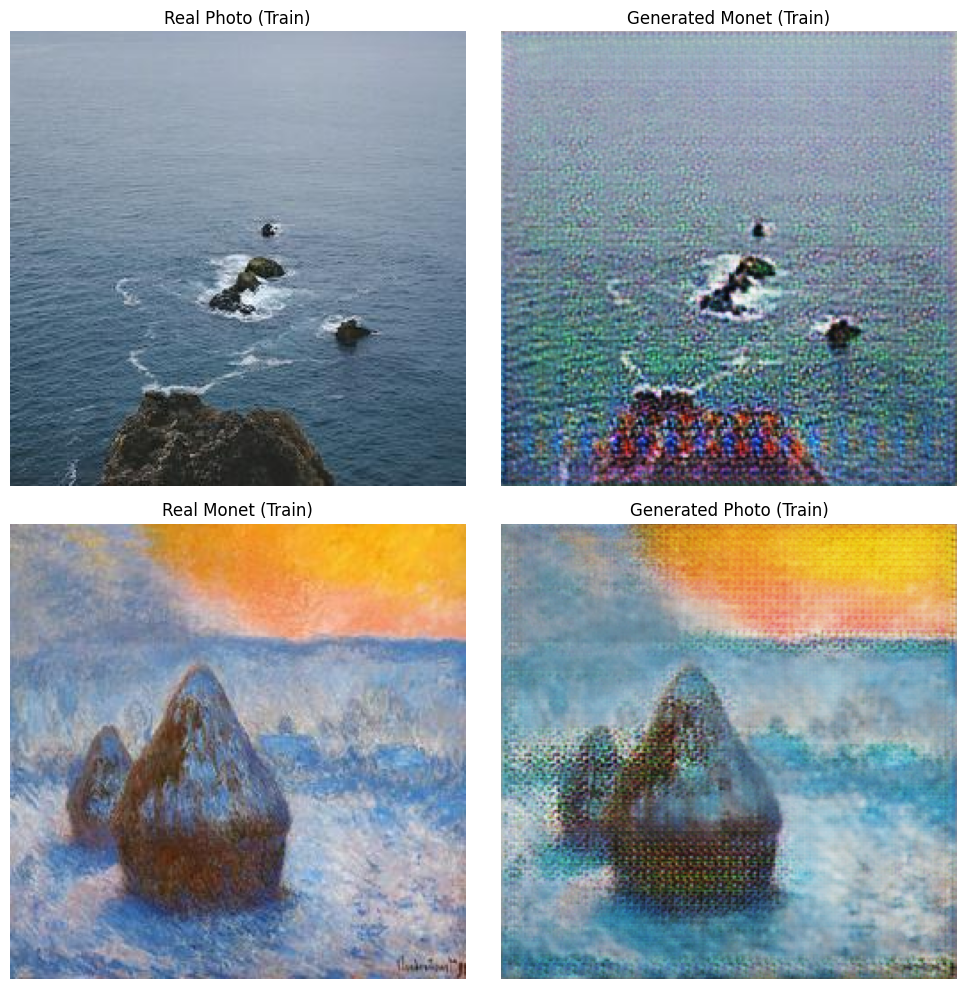

Saved checkpoint for epoch 1 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 2/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 2 finished. Avg Generator Loss: 1.7566
  > D_Monet Loss: 0.2171 | D_Photo Loss: 0.0700
  > Cycle Loss: 0.0733 | Identity Loss: 0.0649 | GAN Loss: 0.5082
--- Visualizing Epoch 2 Results ---


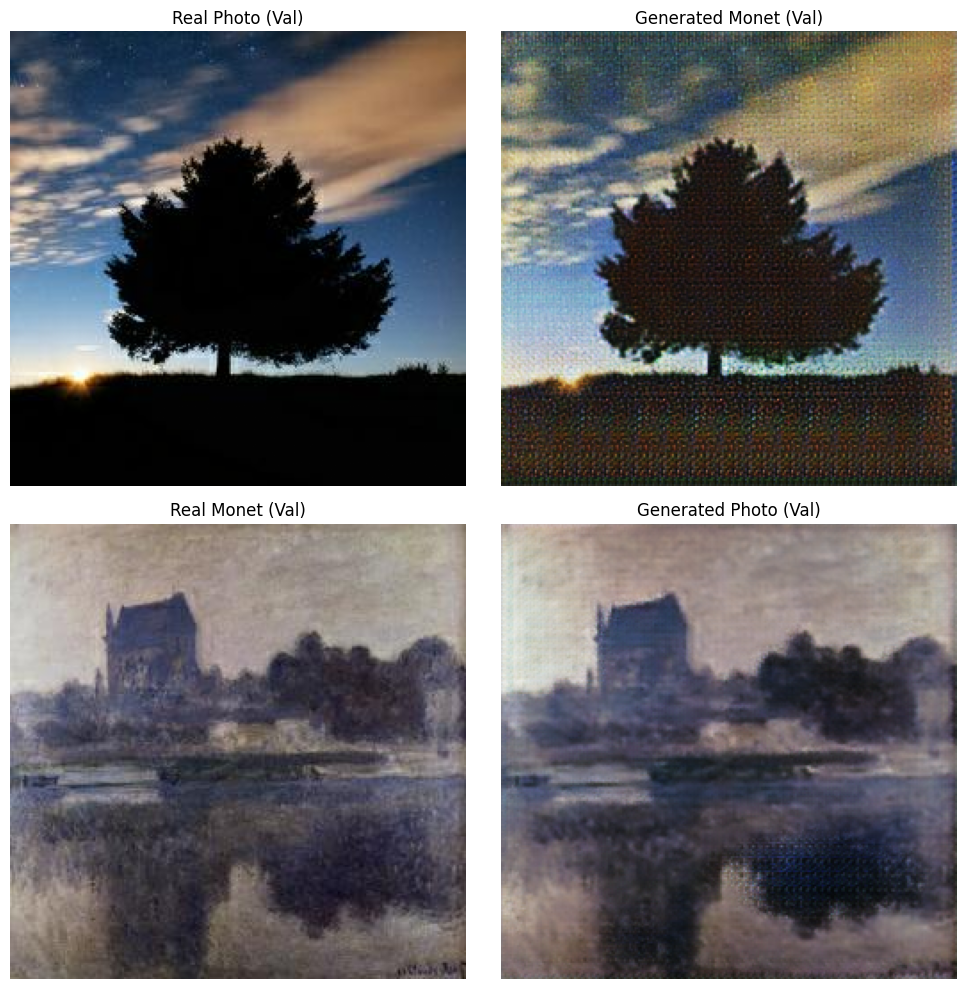

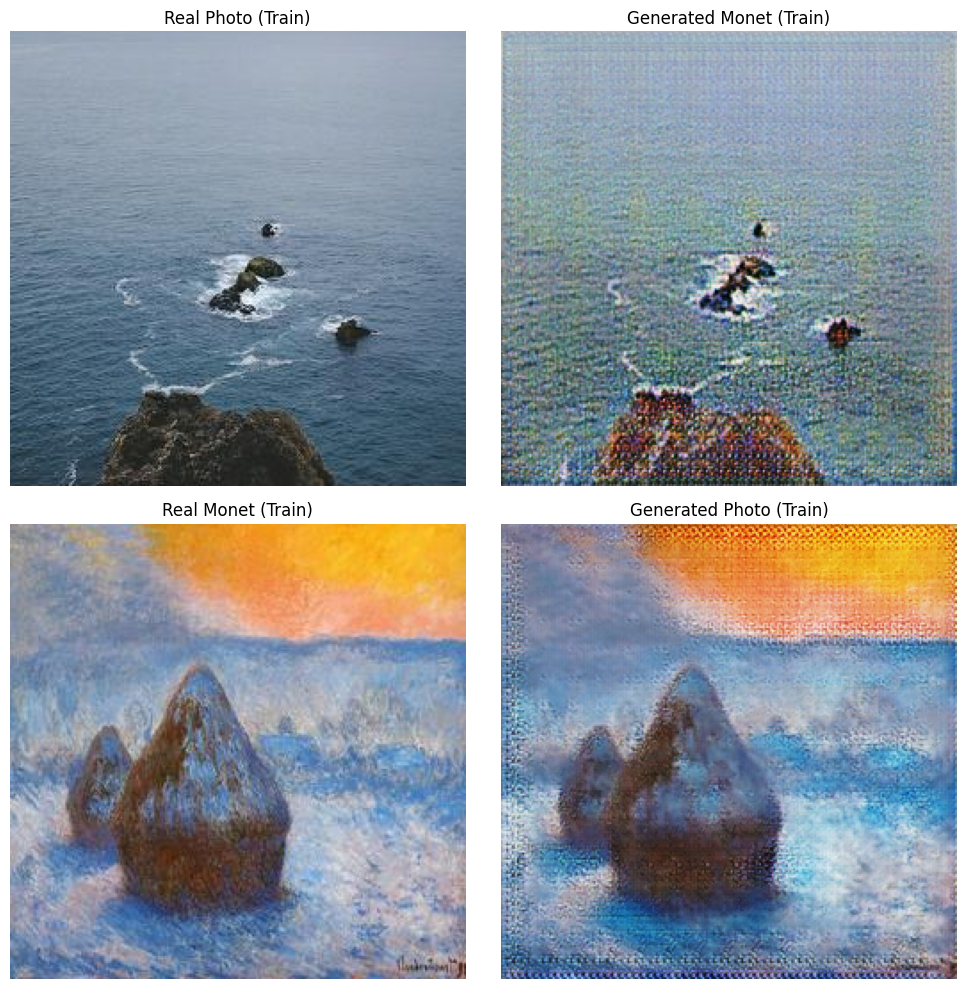

Saved checkpoint for epoch 2 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 3/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 3 finished. Avg Generator Loss: 1.6223
  > D_Monet Loss: 0.1854 | D_Photo Loss: 0.2207
  > Cycle Loss: 0.0916 | Identity Loss: 0.0938 | GAN Loss: 0.3474
--- Visualizing Epoch 3 Results ---


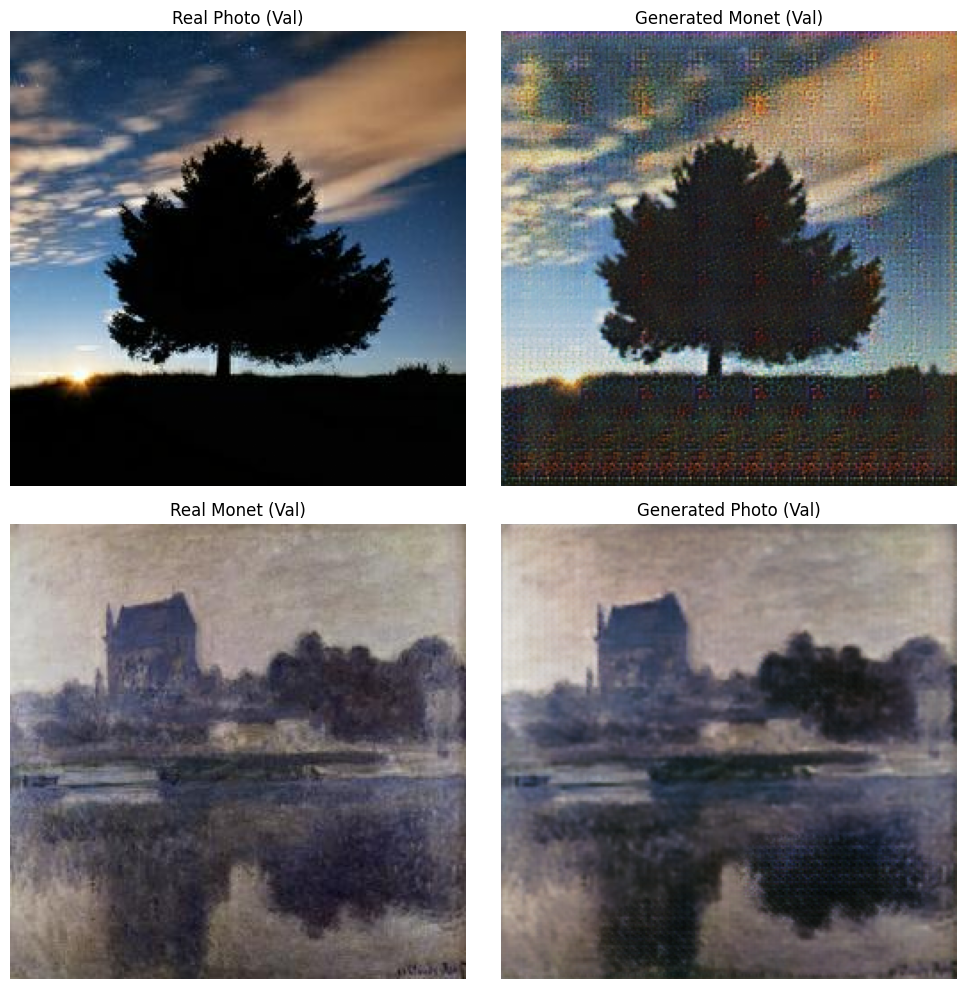

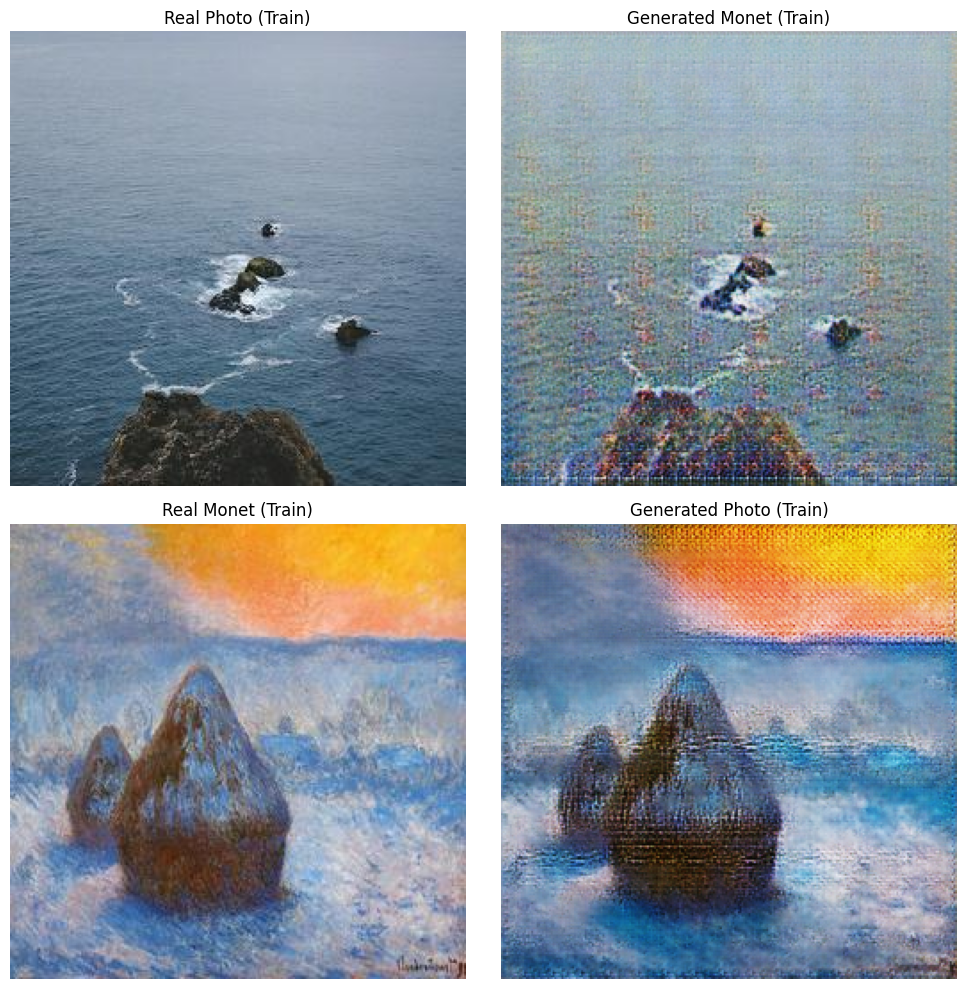

Saved checkpoint for epoch 3 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 4/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 4 finished. Avg Generator Loss: 1.5939
  > D_Monet Loss: 0.1139 | D_Photo Loss: 0.1249
  > Cycle Loss: 0.0774 | Identity Loss: 0.0602 | GAN Loss: 0.4420
--- Visualizing Epoch 4 Results ---


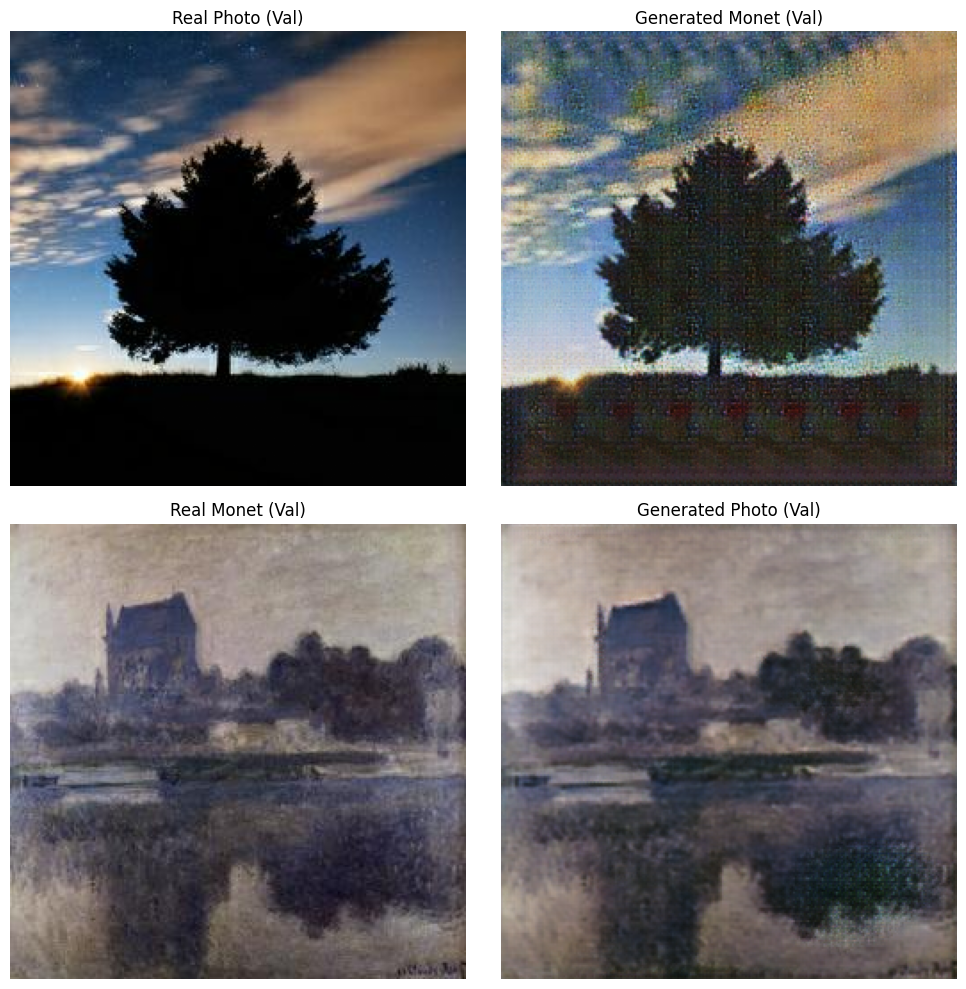

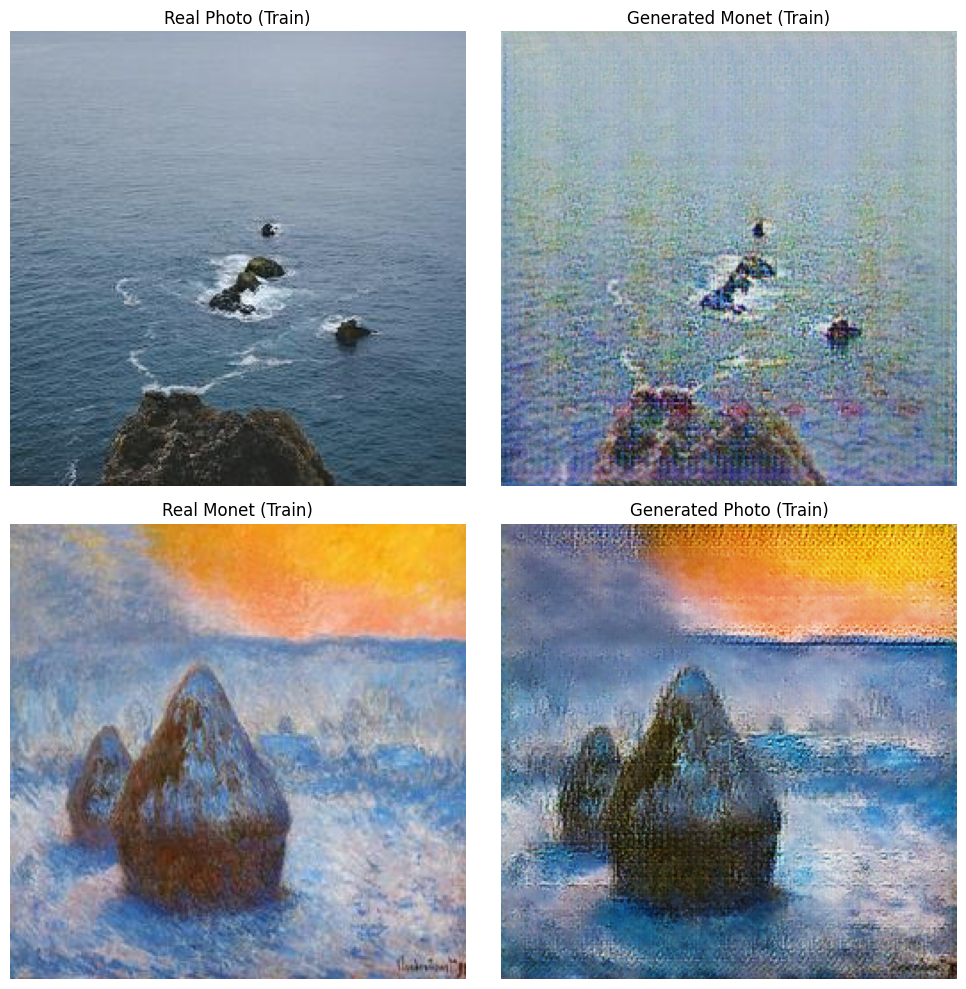

Saved checkpoint for epoch 4 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 5/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 5 finished. Avg Generator Loss: 1.5702
  > D_Monet Loss: 0.2239 | D_Photo Loss: 0.1002
  > Cycle Loss: 0.0899 | Identity Loss: 0.0712 | GAN Loss: 0.5747
--- Visualizing Epoch 5 Results ---


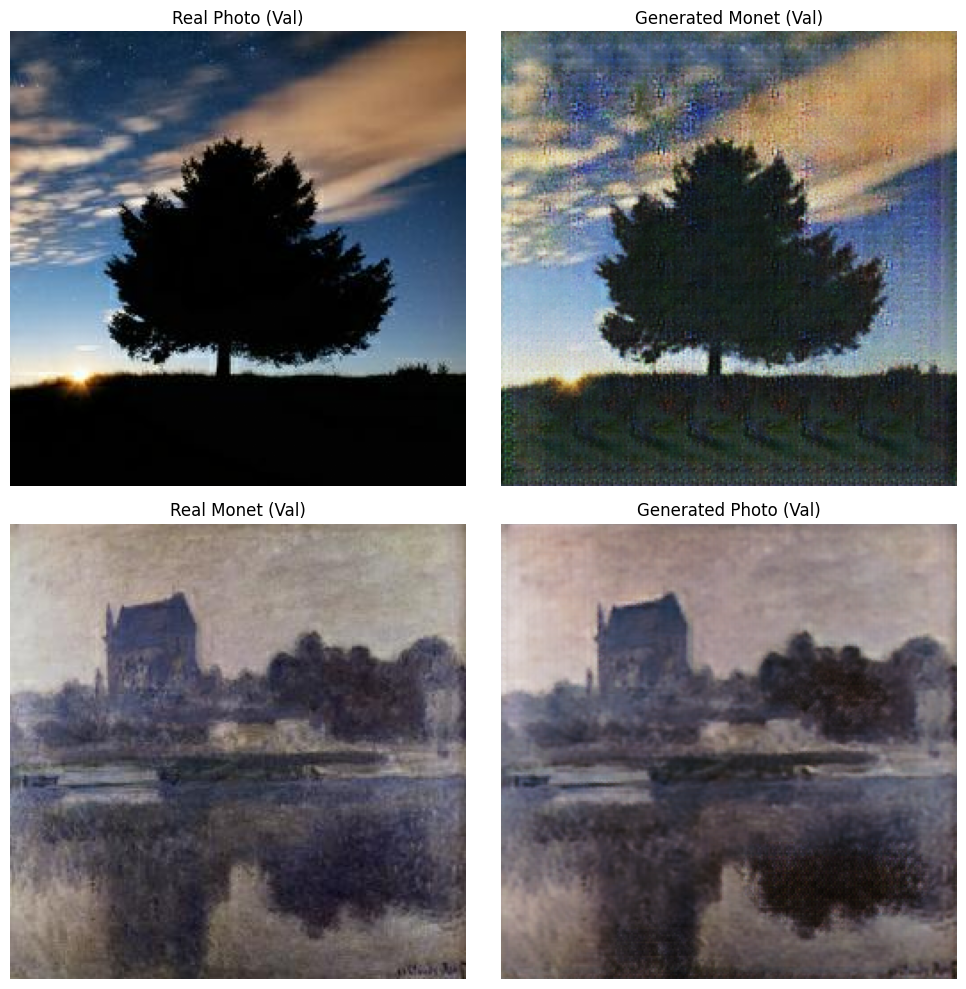

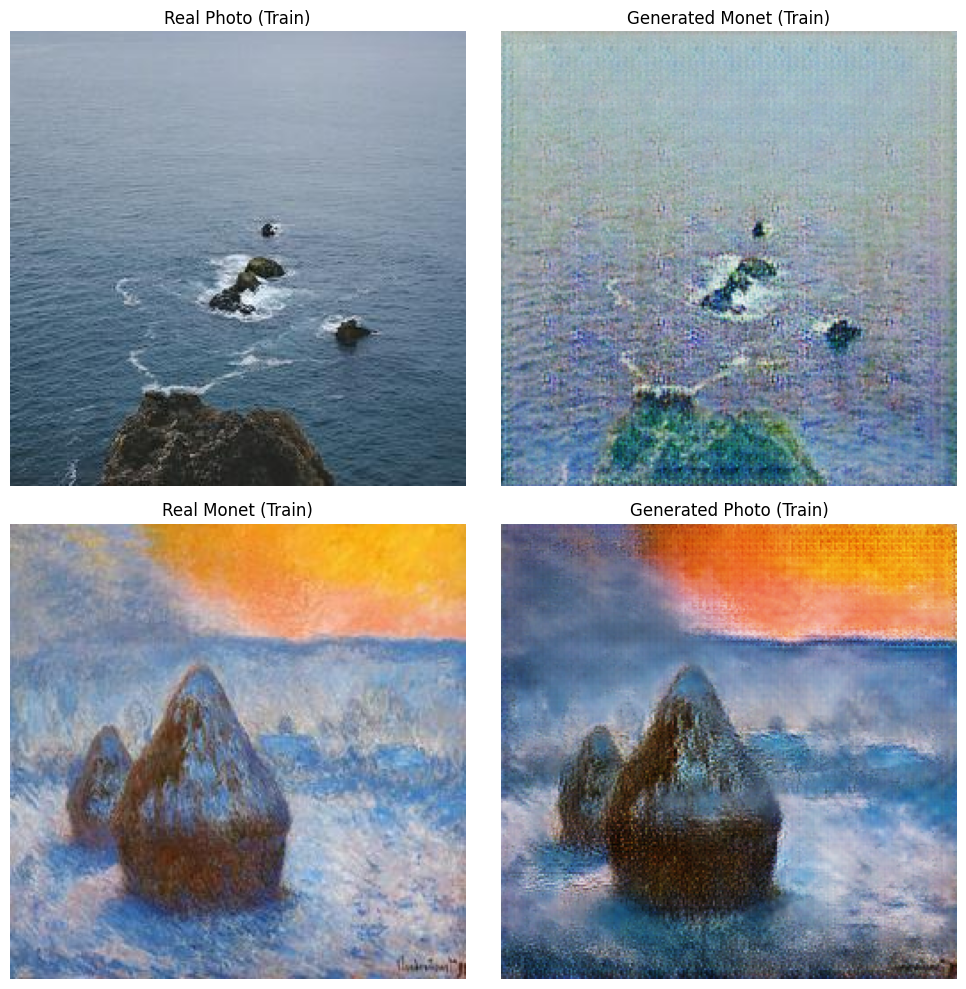

Saved checkpoint for epoch 5 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 6/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 6 finished. Avg Generator Loss: 1.5419
  > D_Monet Loss: 0.1316 | D_Photo Loss: 0.1322
  > Cycle Loss: 0.0706 | Identity Loss: 0.0494 | GAN Loss: 0.4757
--- Visualizing Epoch 6 Results ---


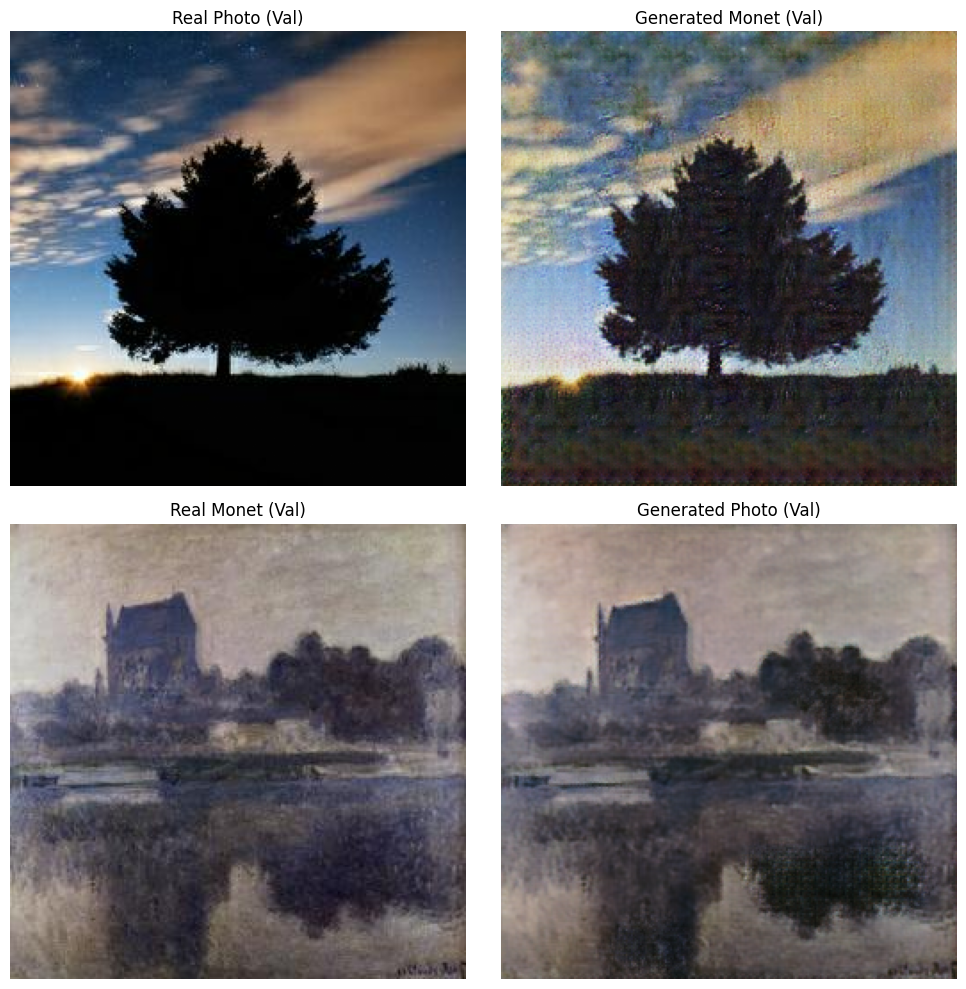

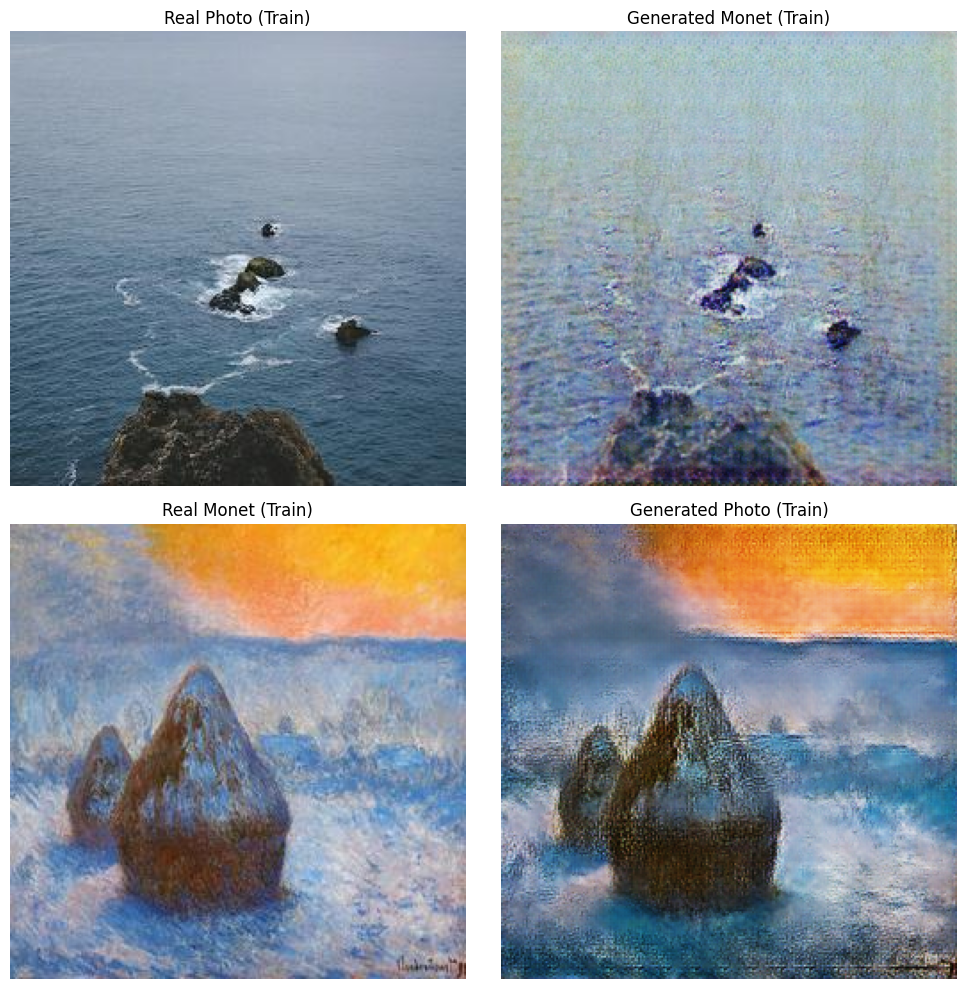

Saved checkpoint for epoch 6 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 7/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 7 finished. Avg Generator Loss: 1.5600
  > D_Monet Loss: 0.1187 | D_Photo Loss: 0.3312
  > Cycle Loss: 0.0781 | Identity Loss: 0.0535 | GAN Loss: 0.5407
--- Visualizing Epoch 7 Results ---


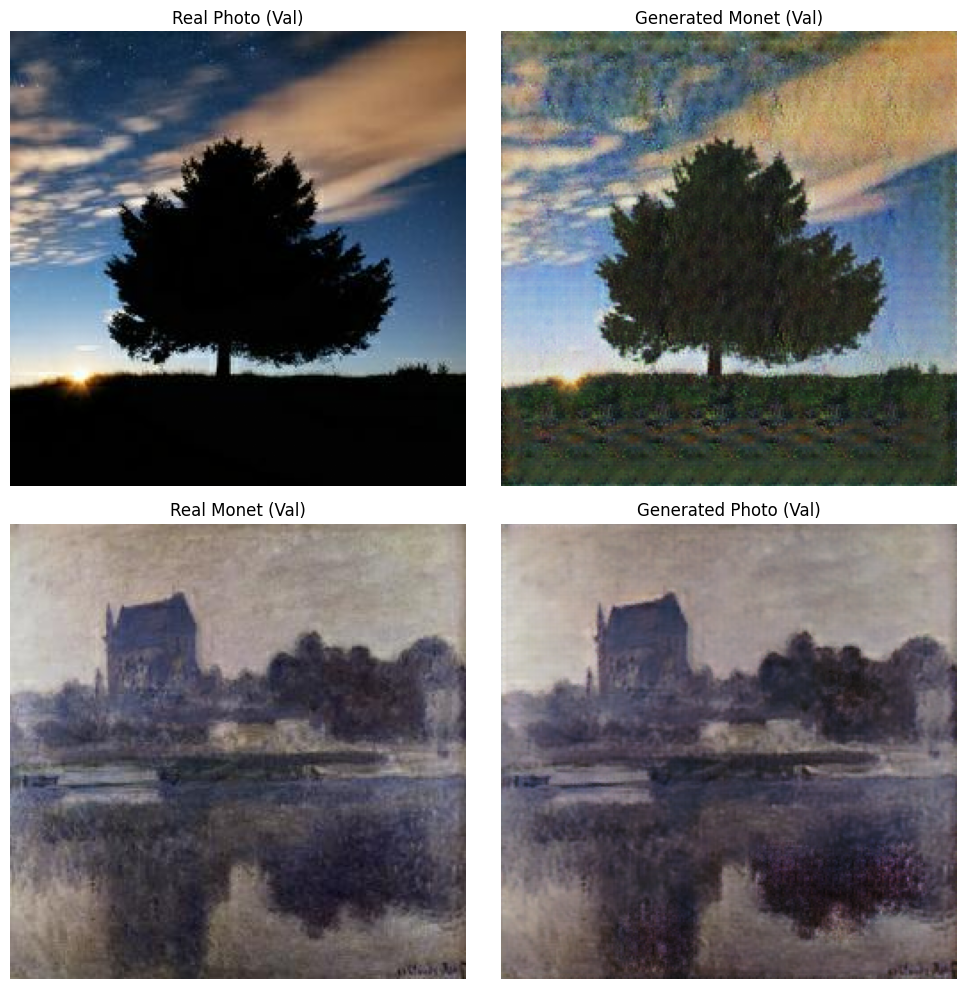

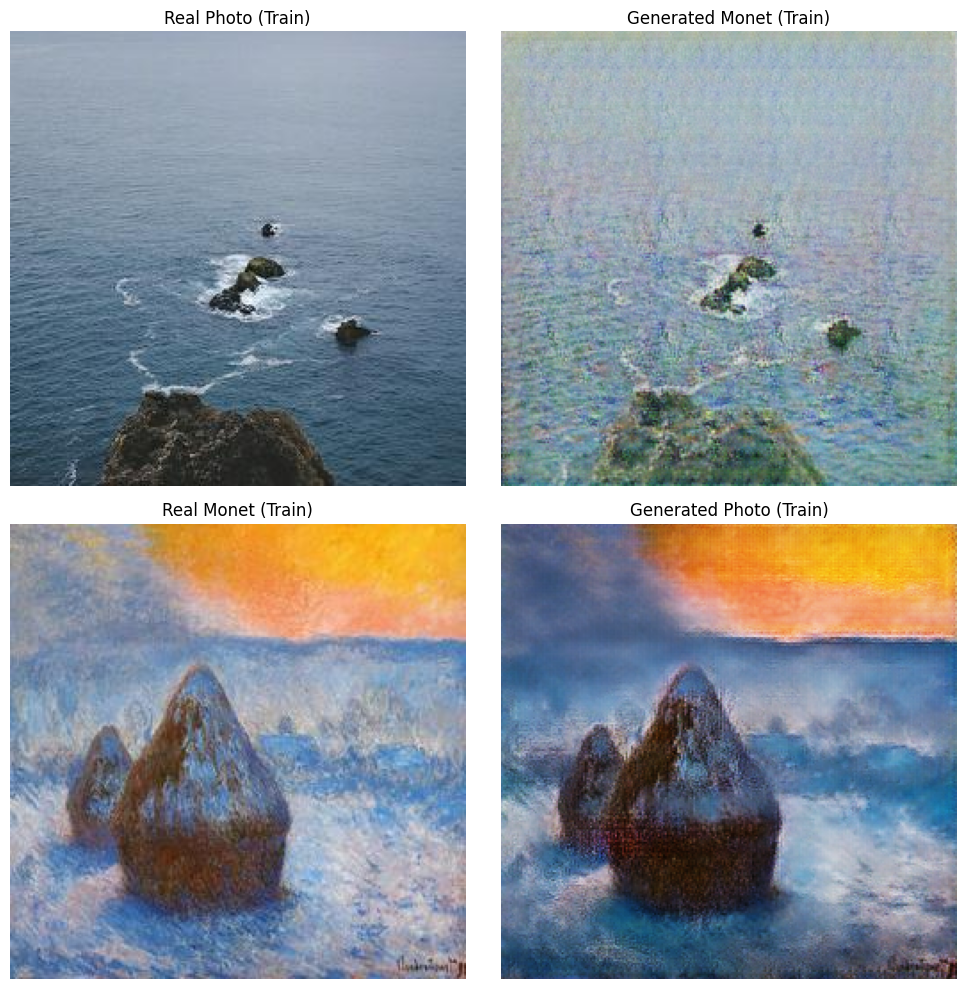

Saved checkpoint for epoch 7 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 8/30:   0%|          | 0/1740 [00:00<?, ?it/s]

Epoch 8 finished. Avg Generator Loss: 1.5602
  > D_Monet Loss: 0.1157 | D_Photo Loss: 0.0939
  > Cycle Loss: 0.0586 | Identity Loss: 0.0402 | GAN Loss: 0.3783
--- Visualizing Epoch 8 Results ---


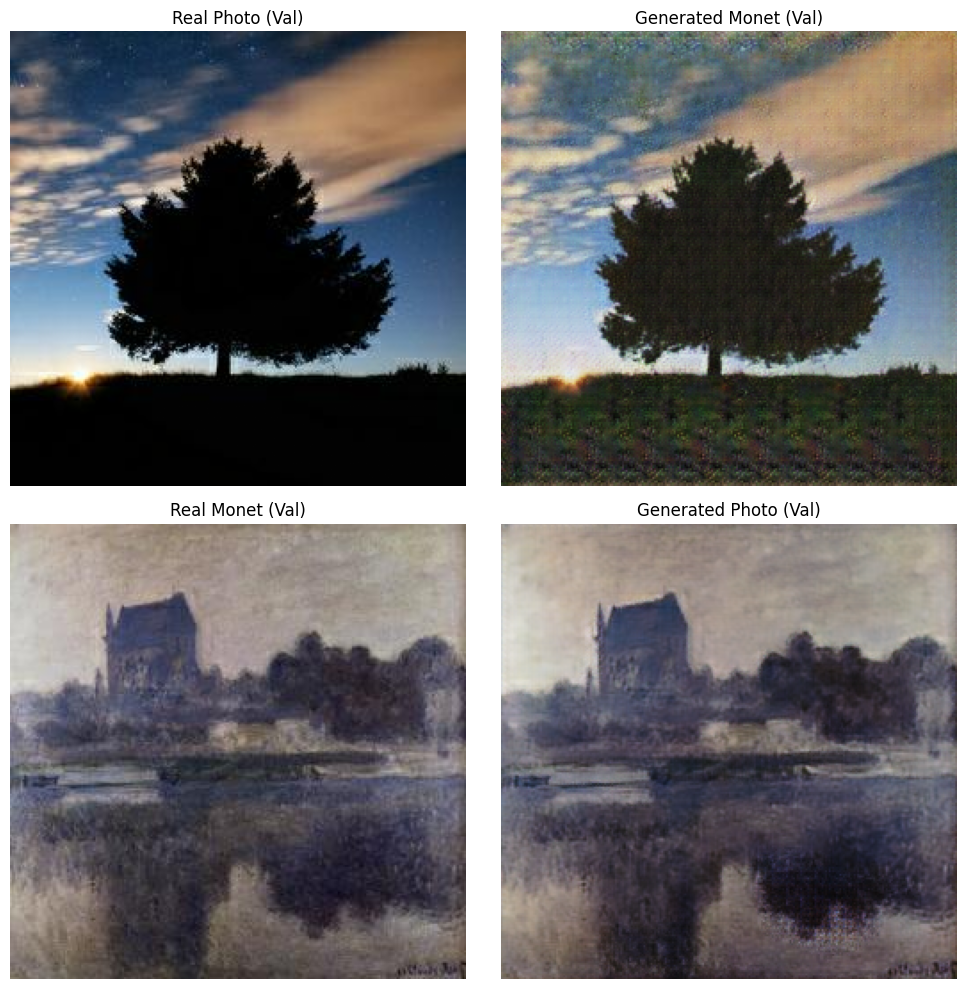

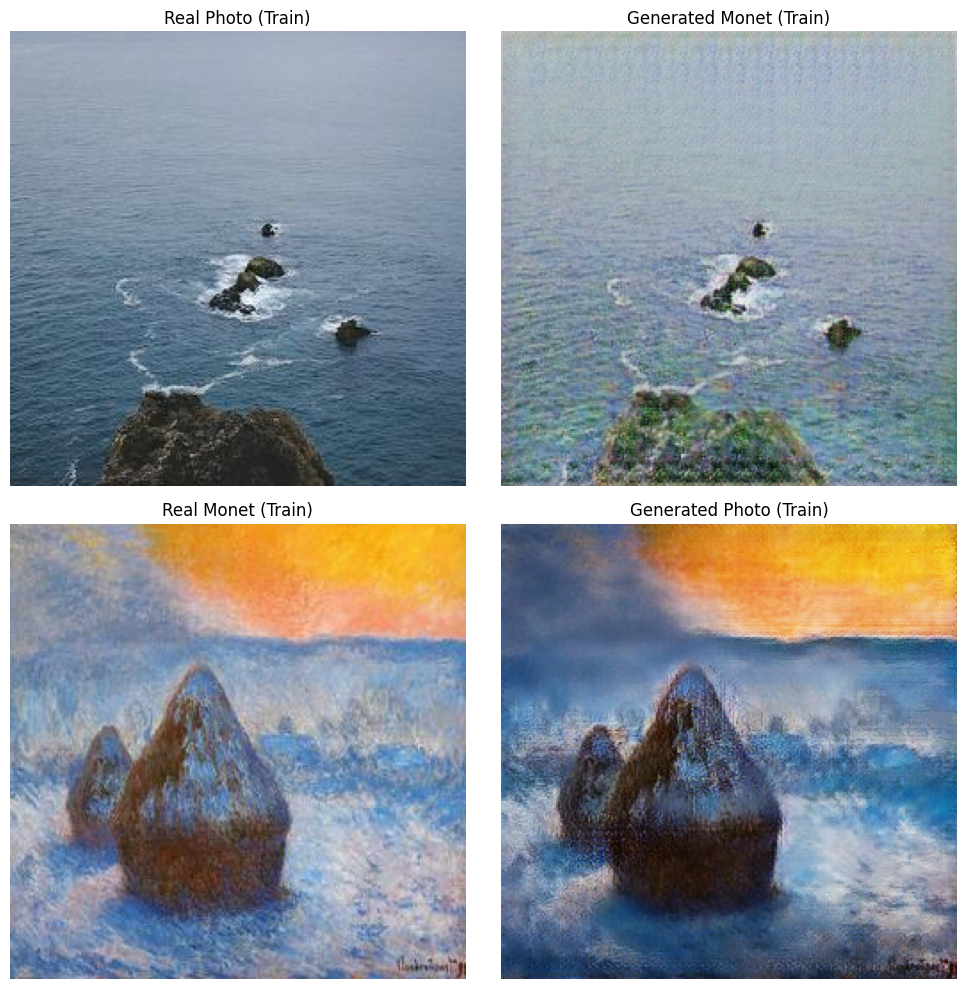

Saved checkpoint for epoch 8 (suffix _4) to /content/drive/MyDrive/MonetGAN_Checkpoints_Exp1


Epoch 9/30:   0%|          | 0/1740 [00:00<?, ?it/s]

In [ ]:
# Training Loop

# Fixed samples for visualization
val_batch = next(iter(val_loader))
fixed_photo_val = val_batch['photo'].to(DEVICE)
fixed_monet_val = val_batch['monet'].to(DEVICE)

train_batch = next(iter(train_loader))
fixed_photo_train = train_batch['photo'].to(DEVICE)
fixed_monet_train = train_batch['monet'].to(DEVICE)

fake_monet_buffer = ReplayBuffer()
fake_photo_buffer = ReplayBuffer()

def show_generated_images(real_p, fake_m, real_m, fake_p, title_suffix=""):
    plt.figure(figsize=(10, 10))
    images = [real_p, fake_m, real_m, fake_p]
    titles = ['Real Photo', 'Generated Monet', 'Real Monet', 'Generated Photo']

    for i, img in enumerate(images):
        plt.subplot(2, 2, i+1)
        plt.imshow(denormalize(img[0]).permute(1, 2, 0).cpu().detach().numpy())
        plt.title(f"{titles[i]} {title_suffix}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

print(f"Starting training from epoch {start_epoch} to {N_EPOCHS}...")

for epoch in range(start_epoch, N_EPOCHS):
    start_time = time.time()

    # --- Training ---
    G_Monet.train(); G_Photo.train(); D_Monet.train(); D_Photo.train()

    epoch_loss_G = 0.0

    for i, batch in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}/{N_EPOCHS}")):
        real_monet = batch['monet'].to(DEVICE)
        real_photo = batch['photo'].to(DEVICE)

        # Train Generators
        optimizer_G.zero_grad()

        loss_id_A = criterion_identity(G_Monet(real_monet), real_monet)
        loss_id_B = criterion_identity(G_Photo(real_photo), real_photo)
        loss_identity = (loss_id_A + loss_id_B) / 2

        fake_monet = G_Monet(real_photo)
        loss_GAN_AB = criterion_GAN(D_Monet(fake_monet), torch.ones_like(D_Monet(fake_monet)))

        fake_photo = G_Photo(real_monet)
        loss_GAN_BA = criterion_GAN(D_Photo(fake_photo), torch.ones_like(D_Photo(fake_photo)))

        loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2

        rec_photo = G_Photo(fake_monet)
        loss_cycle_A = criterion_cycle(rec_photo, real_photo)

        rec_monet = G_Monet(fake_photo)
        loss_cycle_B = criterion_cycle(rec_monet, real_monet)

        loss_cycle = (loss_cycle_A + loss_cycle_B) / 2

        loss_G = loss_GAN + (10.0 * loss_cycle) + (5.0 * loss_identity)
        loss_G.backward()
        optimizer_G.step()

        epoch_loss_G += loss_G.item()

        # Train Discriminators
        optimizer_D_Monet.zero_grad()
        loss_real = criterion_GAN(D_Monet(real_monet), torch.ones_like(D_Monet(real_monet)))
        fake_monet_ = fake_monet_buffer.push_and_pop(fake_monet)
        loss_fake = criterion_GAN(D_Monet(fake_monet_.detach()), torch.zeros_like(D_Monet(fake_monet_)))
        loss_D_Monet = (loss_real + loss_fake) / 2
        loss_D_Monet.backward()
        optimizer_D_Monet.step()

        optimizer_D_Photo.zero_grad()
        loss_real = criterion_GAN(D_Photo(real_photo), torch.ones_like(D_Photo(real_photo)))
        fake_photo_ = fake_photo_buffer.push_and_pop(fake_photo)
        loss_fake = criterion_GAN(D_Photo(fake_photo_.detach()), torch.zeros_like(D_Photo(fake_photo_)))
        loss_D_Photo = (loss_real + loss_fake) / 2
        loss_D_Photo.backward()
        optimizer_D_Photo.step()



    lr_scheduler_G.step()
    lr_scheduler_D_Monet.step()
    lr_scheduler_D_Photo.step()

    print(f"Epoch {epoch+1} finished. Avg Generator Loss: {epoch_loss_G / len(train_loader):.4f}")

    # Print Discriminator Losses for better visibility
    avg_loss_D_Monet = loss_D_Monet.item()
    avg_loss_D_Photo = loss_D_Photo.item()
    print(f"  > D_Monet Loss: {avg_loss_D_Monet:.4f} | D_Photo Loss: {avg_loss_D_Photo:.4f}")
    print(f"  > Cycle Loss: {loss_cycle.item():.4f} | Identity Loss: {loss_identity.item():.4f} | GAN Loss: {loss_GAN.item():.4f}")

    # --- Validation / Visualization ---
    if (epoch + 1) % 1 == 0:
        print(f"--- Visualizing Epoch {epoch+1} Results ---")
        G_Monet.eval()
        G_Photo.eval()
        with torch.no_grad():
            # Validation Sample
            fake_monet_val_vis = G_Monet(fixed_photo_val)
            fake_photo_val_vis = G_Photo(fixed_monet_val)
            show_generated_images(fixed_photo_val, fake_monet_val_vis, fixed_monet_val, fake_photo_val_vis, "(Val)")

            # Training Sample
            fake_monet_train_vis = G_Monet(fixed_photo_train)
            fake_photo_train_vis = G_Photo(fixed_monet_train)
            show_generated_images(fixed_photo_train, fake_monet_train_vis, fixed_monet_train, fake_photo_train_vis, "(Train)")

            # WandB Log Images (Limited to 4 images per epoch: 2 Val, 2 Train)


    # --- Save Checkpoints with _3 suffix ---
    torch.save(G_Monet.state_dict(), os.path.join(CHECKPOINT_DIR, f'G_Monet_epoch_{epoch+1}_4.pth'))
    torch.save(G_Photo.state_dict(), os.path.join(CHECKPOINT_DIR, f'G_Photo_epoch_{epoch+1}_4.pth'))
    torch.save(D_Monet.state_dict(), os.path.join(CHECKPOINT_DIR, f'D_Monet_epoch_{epoch+1}_4.pth'))
    torch.save(D_Photo.state_dict(), os.path.join(CHECKPOINT_DIR, f'D_Photo_epoch_{epoch+1}_4.pth'))
    print(f"Saved checkpoint for epoch {epoch+1} (suffix _4) to {CHECKPOINT_DIR}")

In [ ]:
# --- Testing Phase ---
print("Starting testing phase...")

# Ensure output directory exists for test images if needed locally, though we log to WandB
# We'll rely on WandB logging.

G_Monet.eval()

# Generate and Save Test Results to WandB
print("Generating test results on full Test Set (30 images)...")
test_images_log = []

# Use the test_loader we defined earlier
for i, batch in enumerate(tqdm(test_loader, desc="Testing")):
    real_photo = batch['photo'].to(DEVICE)
    with torch.no_grad():
        fake_monet = G_Monet(real_photo)

    # Log to WandB list
    # Combine Real and Fake side-by-side
    real_img = denormalize(real_photo[0]).cpu()
    fake_img = denormalize(fake_monet[0]).cpu()
    combined = torch.cat((real_img, fake_img), 2)

    test_images_log.append(wandb.Image(combined, caption=f"Test Image {i+1} (Left: Real, Right: Monet)"))



In [ ]:
wandb.finish()